 # hackathon 4:  Clustering - GMM
 ----
  
  University : UTEC
  Course       : ML
  Professor    : Cristian López Del Alamo
  Topic        : Clustering
  End      :     4:00 pm
   

 ----

Write the names and surnames of the members and the percentage of participation of each one in the development of the practice:
 - Integrante 1: (%)
 - Integrante 2: (%)
 - Integrante 3: (%)
 - Integrante 4:  (%)

 ----


**Note: You may use previous codes from other exercises to read images from the database or to display images.**

#1. DataSet

The database has images of people with different facial experiences. Their task will be to group the characteristic vectors that represent these images in clusters where each clister has images of the same person.


The database contains 450 face images, with a resolution of 896 x 592 pixels, in JPEG format. It includes approximately 27 unique people with different lighting conditions, expressions, and backgrounds.


You can use any of the methods you have learned to obtain the feacture vector. For example PCA to obtain the eigefaces. Look in your collabs above how to do this in case I don't remember.



Link dataset: [Clik Here](https://drive.google.com/drive/folders/17JamahfFV7TxSROfkRofksisb5fcaqCA?usp=sharing)



In [14]:
!pip install umap-learn


[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip


In [ ]:
# Instalar dependencias adicionales
!pip install tqdm --quiet

In [15]:
import os
from PIL import Image
import numpy as np

data_path = 'faces'

In [16]:
image_files = sorted([os.path.join(data_path, f) for f in os.listdir(data_path) if f.endswith('.jpg')])
print(f'Total images: {len(image_files)}')

Total images: 450


#  2. Vector Feature and Dimension Reduction

You can use the methods learned in other colabs to obtain the characteristic vectors and reduce the dimension.

For this stage, you should use PCA, t-SNE y  UMAP
You can use the sklearn library for this purpose.

For [PCA](https://scikit-learn.org/dev/modules/generated/sklearn.decomposition.PCA.html), determine the smallest value that retains most of the information, significantly greater than 90%. For [t-SNE](https://scikit-learn.org/1.5/modules/generated/sklearn.manifold.TSNE.html) and [UMAP](https://umap-learn.readthedocs.io/en/latest/), reduce the data to 3 and 2 dimensions, respectively


In [17]:
from sklearn.preprocessing import StandardScaler
from PIL import ImageOps

def load_and_flatten_images(image_files):
    """Carga imágenes con preprocesamiento mejorado"""
    data = []
    for file in image_files:
        img = Image.open(file).convert('L')
        # Ecualizar histograma para mejorar contraste
        img = ImageOps.equalize(img)
        # Redimensionar a tamaño más grande para preservar detalles faciales
        img_resized = img.resize((192, 192))
        img_array = np.array(img_resized).flatten()
        data.append(img_array)
    return np.array(data)

print("Cargando y preprocesando imágenes...")
image_data = load_and_flatten_images(image_files)
scaler = StandardScaler()
image_data = scaler.fit_transform(image_data)
print(f"Forma de datos: {image_data.shape}")

Cargando y preprocesando imágenes...
Forma de datos: (450, 36864)
Forma de datos: (450, 36864)


Componentes para 98% varianza: 346
PCA components: 346
Variance explained: 0.9800
PCA components: 346
Variance explained: 0.9800


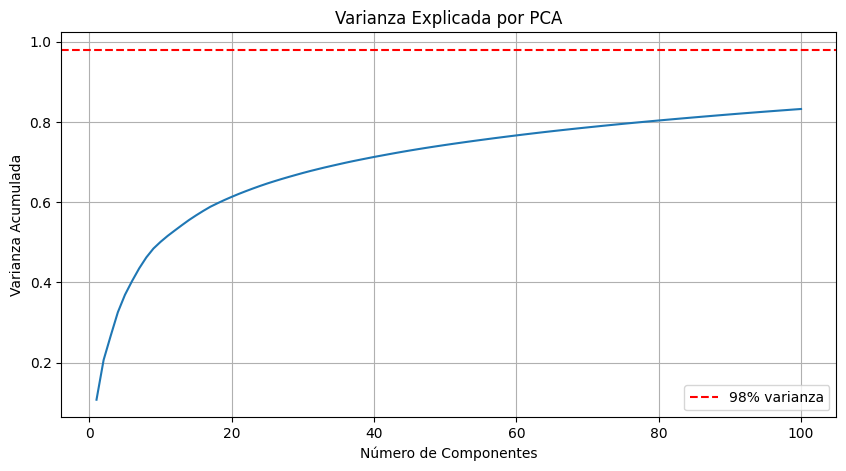

In [18]:
#PCA - Optimizado para retener más información
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Primero veamos cuántos componentes necesitamos para >95% de varianza
pca_full = PCA()
pca_full.fit(image_data)
cumsum_var = np.cumsum(pca_full.explained_variance_ratio_)

# Encontrar componentes para 98% de varianza (mejor que 95%)
n_components_98 = np.argmax(cumsum_var >= 0.98) + 1
print(f'Componentes para 98% varianza: {n_components_98}')

# Aplicar PCA con varianza optimizada
pca = PCA(n_components=0.98)
pca_data = pca.fit_transform(image_data)
print(f'PCA components: {pca.n_components_}')
print(f'Variance explained: {pca.explained_variance_ratio_.sum():.4f}')

# Visualizar varianza acumulada
plt.figure(figsize=(10, 5))
plt.plot(range(1, min(100, len(cumsum_var))+1), cumsum_var[:100])
plt.axhline(y=0.98, color='r', linestyle='--', label='98% varianza')
plt.xlabel('Número de Componentes')
plt.ylabel('Varianza Acumulada')
plt.title('Varianza Explicada por PCA')
plt.legend()
plt.grid(True)
plt.show()

In [19]:
from sklearn.manifold import TSNE
import umap

print("Aplicando t-SNE (esto puede tomar unos minutos)...")
# t-SNE optimizado: perplexity ajustado al tamaño del dataset
# Para ~450 imágenes, perplexity entre 30-50 es óptimo
tsne = TSNE(n_components=3, random_state=42, perplexity=40, max_iter=1500, 
            learning_rate='auto', n_jobs=-1, init='pca')
tsne_data = tsne.fit_transform(pca_data)

print("Aplicando UMAP...")
# UMAP optimizado: n_neighbors más alto para datos faciales
# min_dist bajo para clusters más densos
umap_reducer = umap.UMAP(n_components=2, random_state=42, n_neighbors=30, 
                         min_dist=0.0, metric='cosine', n_jobs=-1)
umap_data = umap_reducer.fit_transform(pca_data)

print(f't-SNE shape: {tsne_data.shape}')
print(f'UMAP shape: {umap_data.shape}')

# Agregar versión de UMAP 3D para mejor clustering
print("Aplicando UMAP 3D...")
umap_3d = umap.UMAP(n_components=3, random_state=42, n_neighbors=30, 
                    min_dist=0.0, metric='cosine', n_jobs=-1)
umap_3d_data = umap_3d.fit_transform(pca_data)
print(f'UMAP 3D shape: {umap_3d_data.shape}')

Aplicando t-SNE (esto puede tomar unos minutos)...
Aplicando UMAP...
Aplicando UMAP...


/Users/jose/Documents/ML-2025-2/ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


t-SNE shape: (450, 3)
UMAP shape: (450, 2)
Aplicando UMAP 3D...


/Users/jose/Documents/ML-2025-2/ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


UMAP 3D shape: (450, 3)


# 3 Clustering and evaluation

You used the Gaussian Mixture model from SKLEARN to cluster the dataset and compared it with other clustering algorithms, such as K-means and DBSCAN. To evaluate the quality of the clusters generated by each model, you employed internal metrics like the Silhouette Coefficient, the Davies-Bouldin Index, and the Dunn Index. These metrics allowed for an analysis of cluster compactness and separation, providing a detailed and comprehensive comparison between the models.

Find de best k for the clustering

In [20]:
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score, davies_bouldin_score, silhouette_samples
from scipy.spatial.distance import pdist, cdist

In [21]:
#Función para Calcular el Dunn Index

def dunn_index(X, labels):
    unique_labels = np.unique(labels)
    unique_labels = unique_labels[unique_labels != -1]
    
    if len(unique_labels) < 2:
        return 0
    
    min_inter_cluster = np.inf
    for i in range(len(unique_labels)):
        for j in range(i + 1, len(unique_labels)):
            cluster_i = X[labels == unique_labels[i]]
            cluster_j = X[labels == unique_labels[j]]
            inter_dist = cdist(cluster_i, cluster_j).min()
            min_inter_cluster = min(min_inter_cluster, inter_dist)
    
    max_intra_cluster = 0
    for label in unique_labels:
        cluster = X[labels == label]
        if len(cluster) > 1:
            intra_dist = pdist(cluster).max()
            max_intra_cluster = max(max_intra_cluster, intra_dist)
    
    return min_inter_cluster / max_intra_cluster if max_intra_cluster > 0 else 0

In [22]:
#Función para Evaluar Cada Cluster

def evaluate_clusters(X, labels):
    silhouette = silhouette_score(X, labels)
    davies_bouldin = davies_bouldin_score(X, labels)
    dunn = dunn_index(X, labels)
    
    results = {
        'Silhouette': silhouette,
        'Davies-Bouldin': davies_bouldin,
        'Dunn': dunn
    }
    
    return results

In [23]:
#Comparativa entre PCA, t-SNE y UMAP - OPTIMIZADA

import pandas as pd
from tqdm import tqdm

results_list = []
# Agregamos UMAP 3D para mejor comparación
datasets = {
    'PCA': pca_data, 
    't-SNE': tsne_data, 
    'UMAP-2D': umap_data,
    'UMAP-3D': umap_3d_data
}

# Expandir rango de K centrado en ~27 personas
k_range = range(22, 33)

print("Evaluando diferentes combinaciones de métodos y K...")
for data_name, data in datasets.items():
    print(f"\nProcesando {data_name}...")
    for k in tqdm(k_range, desc=f'{data_name}'):
        # GMM con covariance 'full' para mejor modelado (más flexible)
        gmm = GaussianMixture(
            n_components=k, 
            random_state=42, 
            covariance_type='full',  # Cambiado de 'diag' a 'full'
            reg_covar=1e-5,  # Regularización más suave
            n_init=20,  # Más inicializaciones
            max_iter=300,  # Más iteraciones
            init_params='k-means++'
        )
        labels_gmm = gmm.fit_predict(data)
        
        # K-Means mejorado
        kmeans = KMeans(
            n_clusters=k, 
            random_state=42, 
            n_init=30,  # Más inicializaciones
            max_iter=500,
            algorithm='elkan'  # Más eficiente para datos densos
        )
        labels_kmeans = kmeans.fit_predict(data)
        
        # Evaluar GMM
        eval_gmm = evaluate_clusters(data, labels_gmm)
        results_list.append({
            'Method': data_name,
            'Algorithm': 'GMM',
            'K': k,
            'BIC': gmm.bic(data),  # Criterio de información bayesiano
            'AIC': gmm.aic(data),  # Criterio de información de Akaike
            **eval_gmm
        })
        
        # Evaluar K-Means
        eval_kmeans = evaluate_clusters(data, labels_kmeans)
        results_list.append({
            'Method': data_name,
            'Algorithm': 'K-Means',
            'K': k,
            'BIC': np.nan,
            'AIC': np.nan,
            **eval_kmeans
        })

results_df = pd.DataFrame(results_list)

# Mostrar top 15 resultados
print("\n" + "="*80)
print("TOP 15 MEJORES RESULTADOS (por Silhouette Score):")
print("="*80)
print(results_df.sort_values('Silhouette', ascending=False).head(15).to_string())

# Mostrar mejores resultados por Davies-Bouldin (menor es mejor)
print("\n" + "="*80)
print("TOP 10 MEJORES RESULTADOS (por Davies-Bouldin - menor es mejor):")
print("="*80)
print(results_df.sort_values('Davies-Bouldin', ascending=True).head(10).to_string())

Evaluando diferentes combinaciones de métodos y K...

Procesando PCA...


PCA: 100%|██████████| 11/11 [00:25<00:00,  2.31s/it]



Procesando t-SNE...


t-SNE: 100%|██████████| 11/11 [00:08<00:00,  1.27it/s]



Procesando UMAP-2D...


UMAP-2D: 100%|██████████| 11/11 [00:05<00:00,  1.96it/s]



Procesando UMAP-3D...


UMAP-3D: 100%|██████████| 11/11 [00:04<00:00,  2.22it/s]


TOP 15 MEJORES RESULTADOS (por Silhouette Score):
     Method Algorithm   K  BIC  AIC  Silhouette  Davies-Bouldin      Dunn
51  UMAP-2D   K-Means  25  NaN  NaN    0.440353        0.730120  0.066508
49  UMAP-2D   K-Means  24  NaN  NaN    0.438188        0.730561  0.066508
61  UMAP-2D   K-Means  30  NaN  NaN    0.437607        0.732355  0.065971
47  UMAP-2D   K-Means  23  NaN  NaN    0.434707        0.736478  0.060464
45  UMAP-2D   K-Means  22  NaN  NaN    0.433274        0.734812  0.080095
57  UMAP-2D   K-Means  28  NaN  NaN    0.432807        0.718564  0.065004
63  UMAP-2D   K-Means  31  NaN  NaN    0.431484        0.732666  0.047048
79  UMAP-3D   K-Means  28  NaN  NaN    0.429099        0.772266  0.085791
55  UMAP-2D   K-Means  27  NaN  NaN    0.428377        0.747491  0.041153
85  UMAP-3D   K-Means  31  NaN  NaN    0.424115        0.756970  0.083823
87  UMAP-3D   K-Means  32  NaN  NaN    0.423963        0.779280  0.076041
65  UMAP-2D   K-Means  32  NaN  NaN    0.423597        0.7578

# 4. Clustering visualization

Project the elements of each cluster into a 2D space, then plot the points, assigning a unique color to each cluster to visualize the separation between them. Randomly select 10 images from each group and display them on the screen, allowing a visual check to determine if the images indeed belong to the same person.

In [ ]:
# Análisis adicional: Gráficos de BIC/AIC y métricas
import matplotlib.pyplot as plt

# Filtrar solo resultados de GMM para análisis BIC/AIC
gmm_results = results_df[results_df['Algorithm'] == 'GMM'].copy()

fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# 1. Silhouette Score por K y Método
for method in results_df['Method'].unique():
    method_data = results_df[results_df['Method'] == method]
    for algo in method_data['Algorithm'].unique():
        algo_data = method_data[method_data['Algorithm'] == algo]
        axes[0, 0].plot(algo_data['K'], algo_data['Silhouette'], 
                       marker='o', label=f'{method}-{algo}', linewidth=2)

axes[0, 0].set_xlabel('Número de Clusters (K)', fontsize=12)
axes[0, 0].set_ylabel('Silhouette Score', fontsize=12)
axes[0, 0].set_title('Silhouette Score vs K', fontsize=14, fontweight='bold')
axes[0, 0].legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
axes[0, 0].grid(True, alpha=0.3)

# 2. Davies-Bouldin Index por K (menor es mejor)
for method in results_df['Method'].unique():
    method_data = results_df[results_df['Method'] == method]
    for algo in method_data['Algorithm'].unique():
        algo_data = method_data[method_data['Algorithm'] == algo]
        axes[0, 1].plot(algo_data['K'], algo_data['Davies-Bouldin'], 
                       marker='o', label=f'{method}-{algo}', linewidth=2)

axes[0, 1].set_xlabel('Número de Clusters (K)', fontsize=12)
axes[0, 1].set_ylabel('Davies-Bouldin Index', fontsize=12)
axes[0, 1].set_title('Davies-Bouldin Index vs K (menor es mejor)', fontsize=14, fontweight='bold')
axes[0, 1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
axes[0, 1].grid(True, alpha=0.3)

# 3. BIC para GMM
for method in gmm_results['Method'].unique():
    method_data = gmm_results[gmm_results['Method'] == method]
    axes[1, 0].plot(method_data['K'], method_data['BIC'], 
                   marker='s', label=f'{method}', linewidth=2)

axes[1, 0].set_xlabel('Número de Clusters (K)', fontsize=12)
axes[1, 0].set_ylabel('BIC', fontsize=12)
axes[1, 0].set_title('BIC vs K para GMM (menor es mejor)', fontsize=14, fontweight='bold')
axes[1, 0].legend(fontsize=10)
axes[1, 0].grid(True, alpha=0.3)

# 4. Dunn Index por K (mayor es mejor)
for method in results_df['Method'].unique():
    method_data = results_df[results_df['Method'] == method]
    for algo in method_data['Algorithm'].unique():
        algo_data = method_data[method_data['Algorithm'] == algo]
        axes[1, 1].plot(algo_data['K'], algo_data['Dunn'], 
                       marker='o', label=f'{method}-{algo}', linewidth=2)

axes[1, 1].set_xlabel('Número de Clusters (K)', fontsize=12)
axes[1, 1].set_ylabel('Dunn Index', fontsize=12)
axes[1, 1].set_title('Dunn Index vs K (mayor es mejor)', fontsize=14, fontweight='bold')
axes[1, 1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
axes[1, 1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("\nINTERPRETACIÓN DE MÉTRICAS:")
print("- Silhouette Score: Más alto es mejor (rango [-1, 1])")
print("- Davies-Bouldin Index: Más bajo es mejor")
print("- Dunn Index: Más alto es mejor")
print("- BIC/AIC: Más bajo es mejor (solo para GMM)")


MEJOR CONFIGURACIÓN ENCONTRADA:
Método: UMAP-2D
Algoritmo: K-Means
K (número de clusters): 25
Silhouette Score: 0.4404
Davies-Bouldin Index: 0.7301
Dunn Index: 0.0665



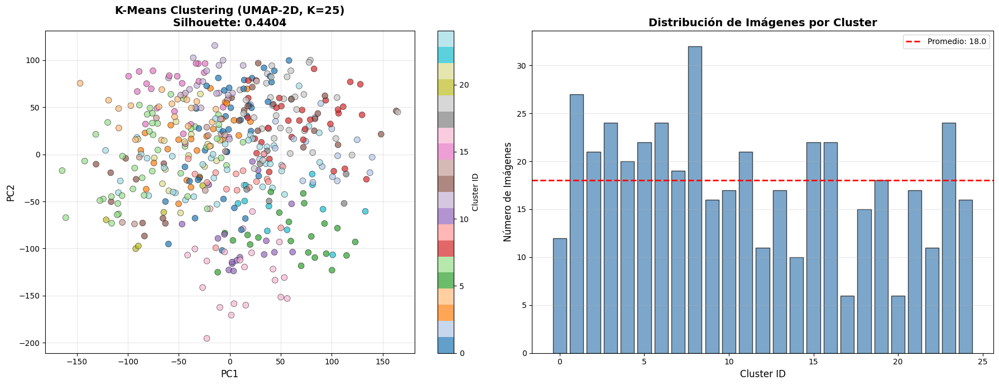


ESTADÍSTICAS DE CLUSTERS:
Total de imágenes: 450
Número de clusters: 25
Promedio de imágenes por cluster: 18.00
Desviación estándar: 6.20
Cluster más pequeño: 6 imágenes
Cluster más grande: 32 imágenes


In [24]:
#Dimensionalidad a 2D y Visualización de Clusters - MEJORADA

import matplotlib.pyplot as plt
import random

# Seleccionar el mejor modelo
best_row = results_df.sort_values('Silhouette', ascending=False).iloc[0]
best_method = best_row['Method']
best_k = int(best_row['K'])
best_algorithm = best_row['Algorithm']

print(f"\n{'='*80}")
print(f"MEJOR CONFIGURACIÓN ENCONTRADA:")
print(f"{'='*80}")
print(f"Método: {best_method}")
print(f"Algoritmo: {best_algorithm}")
print(f"K (número de clusters): {best_k}")
print(f"Silhouette Score: {best_row['Silhouette']:.4f}")
print(f"Davies-Bouldin Index: {best_row['Davies-Bouldin']:.4f}")
print(f"Dunn Index: {best_row['Dunn']:.4f}")
if best_algorithm == 'GMM':
    print(f"BIC: {best_row['BIC']:.2f}")
    print(f"AIC: {best_row['AIC']:.2f}")
print(f"{'='*80}\n")

data_to_use = datasets[best_method]

# Entrenar el modelo final con los mejores parámetros
if best_algorithm == 'GMM':
    model = GaussianMixture(
        n_components=best_k, 
        random_state=42, 
        covariance_type='full',
        reg_covar=1e-5,
        n_init=20,
        max_iter=300,
        init_params='k-means++'
    )
else:
    model = KMeans(
        n_clusters=best_k, 
        random_state=42, 
        n_init=30,
        max_iter=500,
        algorithm='elkan'
    )

best_labels = model.fit_predict(data_to_use)

# Visualizar en 2D usando PCA
pca_2d = PCA(n_components=2)
data_2d = pca_2d.fit_transform(pca_data)

# Crear visualización mejorada
fig, axes = plt.subplots(1, 2, figsize=(18, 7))

# Gráfico 1: Scatter plot de clusters
scatter = axes[0].scatter(data_2d[:, 0], data_2d[:, 1], c=best_labels, 
                         cmap='tab20', s=60, alpha=0.7, edgecolors='black', linewidth=0.5)
axes[0].set_title(f'{best_algorithm} Clustering ({best_method}, K={best_k})\nSilhouette: {best_row["Silhouette"]:.4f}', 
                 fontsize=14, fontweight='bold')
axes[0].set_xlabel('PC1', fontsize=12)
axes[0].set_ylabel('PC2', fontsize=12)
axes[0].grid(True, alpha=0.3)
plt.colorbar(scatter, ax=axes[0], label='Cluster ID')

# Gráfico 2: Distribución de imágenes por cluster
unique, counts = np.unique(best_labels, return_counts=True)
axes[1].bar(unique, counts, color='steelblue', edgecolor='black', alpha=0.7)
axes[1].set_title('Distribución de Imágenes por Cluster', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Cluster ID', fontsize=12)
axes[1].set_ylabel('Número de Imágenes', fontsize=12)
axes[1].grid(True, alpha=0.3, axis='y')

# Añadir línea horizontal con el promedio esperado (~450/27 ≈ 17 imágenes por persona)
avg_images = len(image_files) / best_k
axes[1].axhline(y=avg_images, color='red', linestyle='--', linewidth=2, 
               label=f'Promedio: {avg_images:.1f}')
axes[1].legend()

plt.tight_layout()
plt.show()

# Estadísticas adicionales
print(f"\nESTADÍSTICAS DE CLUSTERS:")
print(f"Total de imágenes: {len(image_files)}")
print(f"Número de clusters: {best_k}")
print(f"Promedio de imágenes por cluster: {np.mean(counts):.2f}")
print(f"Desviación estándar: {np.std(counts):.2f}")
print(f"Cluster más pequeño: {np.min(counts)} imágenes")
print(f"Cluster más grande: {np.max(counts)} imágenes")


Mostrando 10 imágenes aleatorias de cada cluster...
Total de clusters: 25



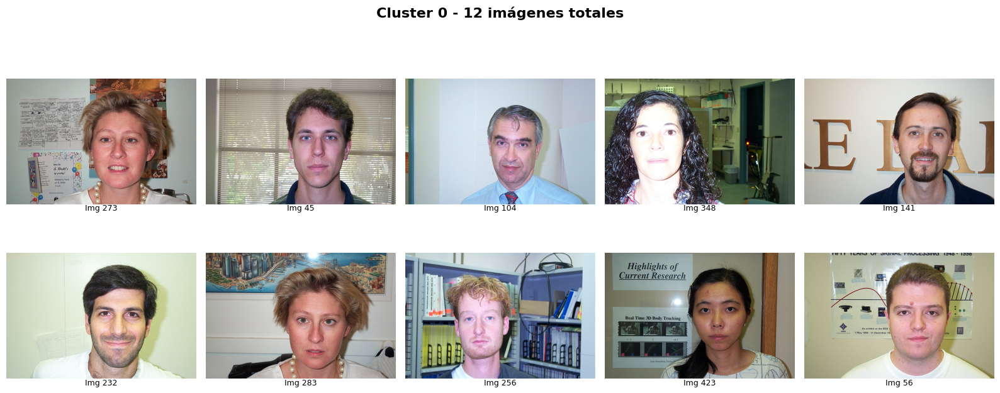

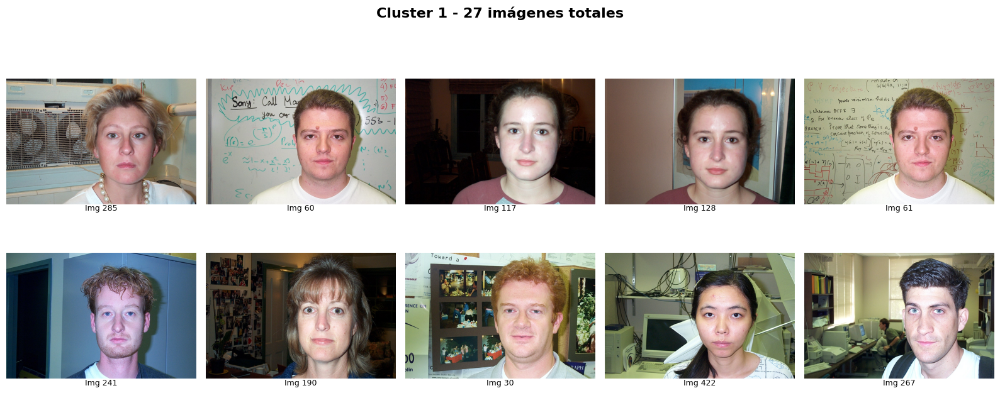

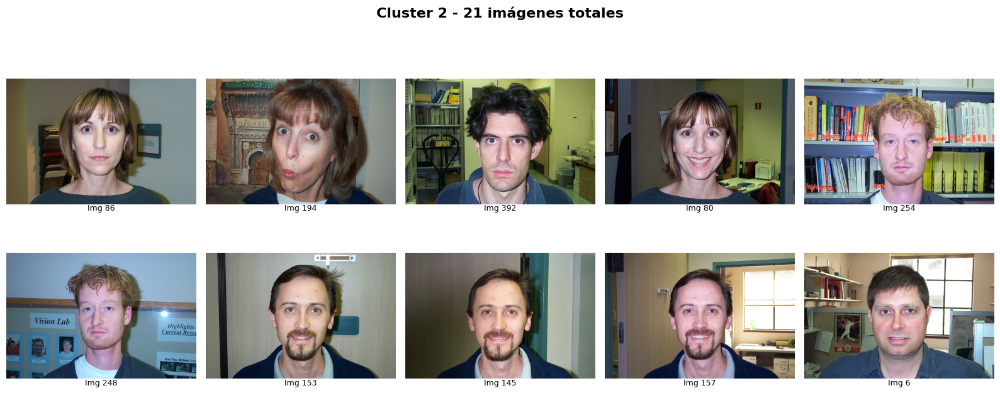

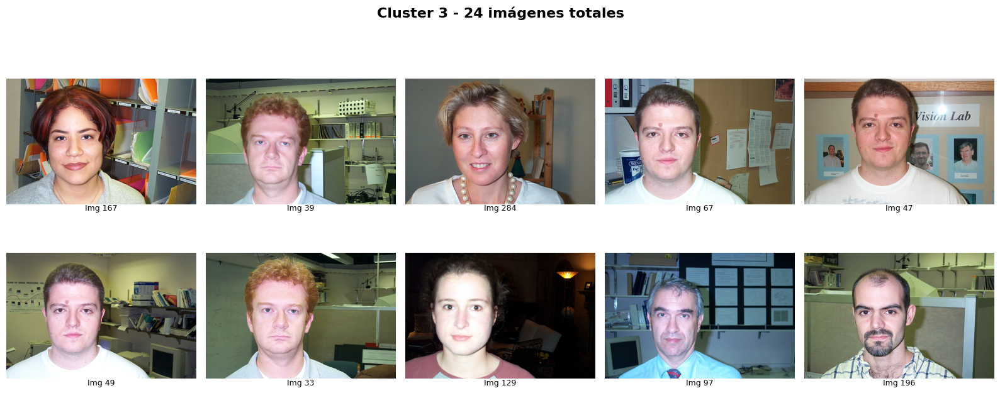

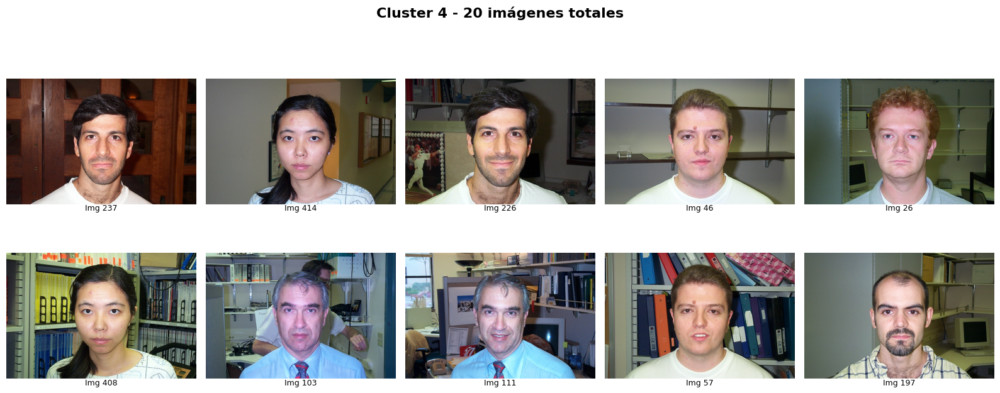

...

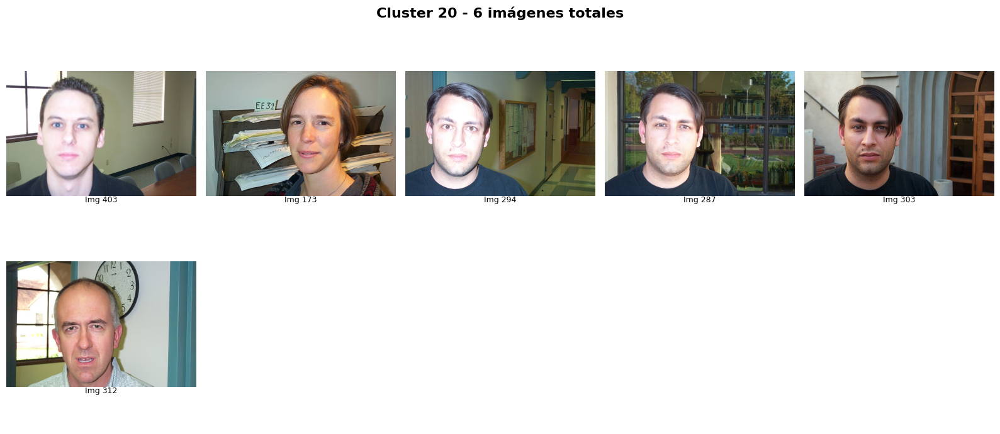

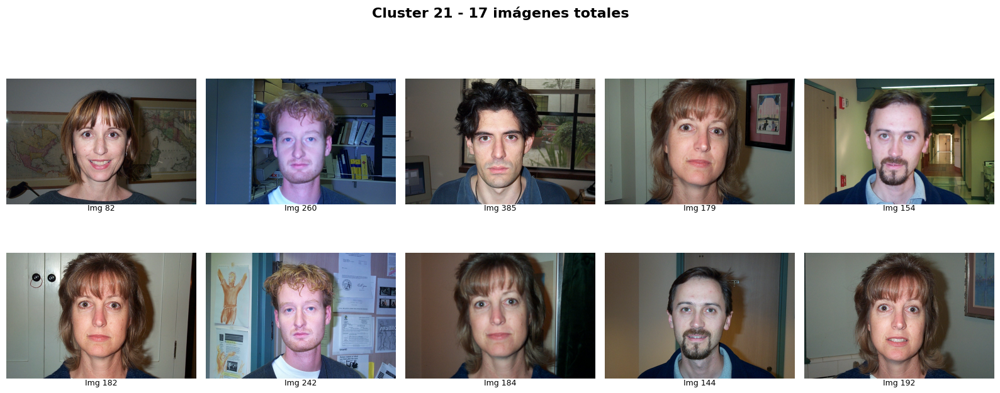

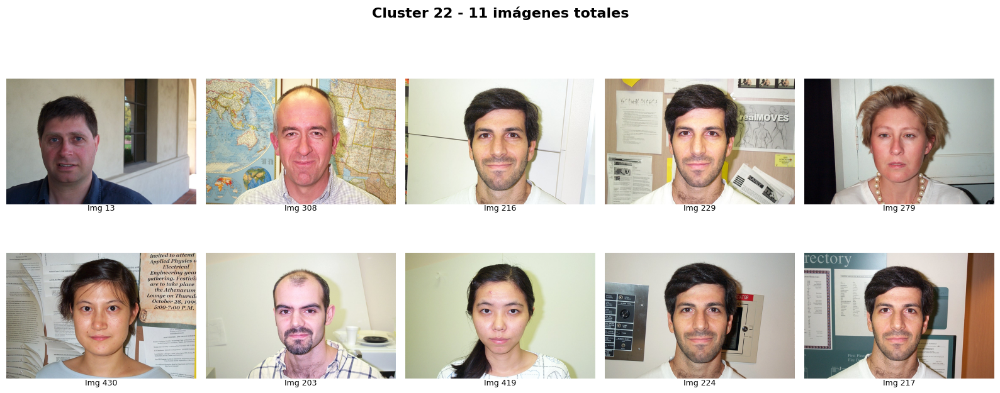

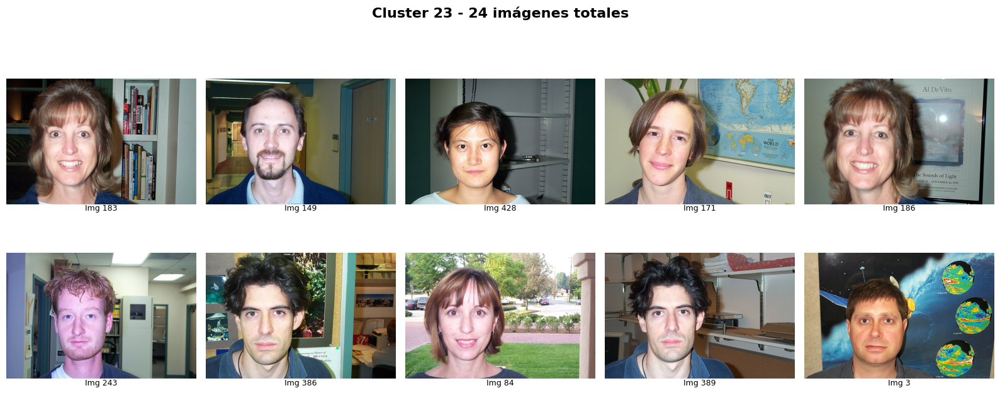

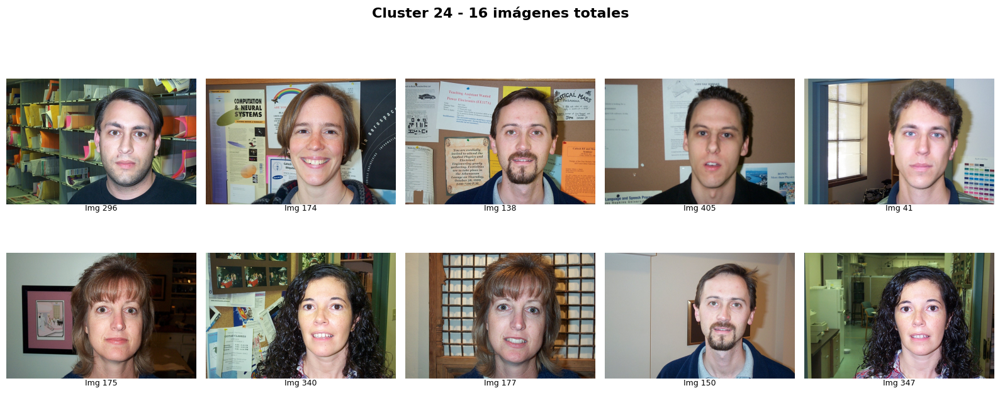


ANÁLISIS COMPLETADO
Verifica visualmente si las imágenes en cada cluster pertenecen a la misma persona.
Si hay clusters con personas mezcladas, considera ajustar los hiperparámetros.


In [25]:
#Mostrar Imágenes - TODOS LOS CLUSTERS

def display_random_images_per_cluster(image_files, labels, num_images=10, max_clusters=None):
    """
    Muestra imágenes aleatorias de cada cluster
    
    Args:
        image_files: lista de rutas de imágenes
        labels: etiquetas de cluster
        num_images: número de imágenes a mostrar por cluster
        max_clusters: número máximo de clusters a visualizar (None = todos)
    """
    unique_labels = np.unique(labels)
    
    if max_clusters is not None:
        unique_labels = unique_labels[:max_clusters]
    
    print(f"\nMostrando {num_images} imágenes aleatorias de cada cluster...")
    print(f"Total de clusters: {len(unique_labels)}\n")
    
    for label in unique_labels:
        cluster_indices = np.where(labels == label)[0]
        
        if len(cluster_indices) == 0:
            continue
        
        sample_size = min(num_images, len(cluster_indices))
        sample_indices = random.sample(list(cluster_indices), sample_size)
        
        # Crear grid de imágenes
        fig, axes = plt.subplots(2, 5, figsize=(16, 7))
        fig.suptitle(f'Cluster {label} - {len(cluster_indices)} imágenes totales', 
                    fontsize=16, fontweight='bold')
        
        for idx, ax in enumerate(axes.flat):
            if idx < len(sample_indices):
                img = Image.open(image_files[sample_indices[idx]])
                ax.imshow(img, cmap='gray')
                ax.axis('off')
                # Mostrar índice de la imagen
                ax.text(0.5, -0.05, f'Img {sample_indices[idx]}', 
                       transform=ax.transAxes, ha='center', fontsize=9)
            else:
                ax.axis('off')
        
        plt.tight_layout()
        plt.show()

# Mostrar TODOS los clusters (no solo los primeros 5)
display_random_images_per_cluster(image_files, best_labels, num_images=10, max_clusters=None)

print("\n" + "="*80)
print("ANÁLISIS COMPLETADO")
print("="*80)
print(f"Verifica visualmente si las imágenes en cada cluster pertenecen a la misma persona.")
print(f"Si hay clusters con personas mezcladas, considera ajustar los hiperparámetros.")

# 5. Análisis de Calidad por Cluster

Analiza la calidad de cada cluster individual usando el Silhouette Score por muestra.